In [2]:
# 정규성 검정

# 평균-분산 포트폴리오 이론이나 자본 자산 가격결정 모형과 같은 많은 중요한 금융 모형들은 증권 수익률이 정규분포라는 가정을 하고 있다.
# 따라서 이번 장에서는 주어진 시계열의 수익률에 대한 정규성을 검정하는 몇 가지 방법을 다뤄보자

# 주성분 분석
# 주성분 분석(PCA)은 주식 투자 전략을 집행하거나 이자율 움직임을 설명 하는 주요 성분을 분석하는 인기 있는 금융 분석 도구이다.
# 주성분 분석의 가장 큰 이점은 수많은 서로 연관된 시계열 성분들로부터 소수의 선형-독립적인 (혹은 상관관계가 없는) 성분을 이끌어내어 분석의 복잡도를 줄인다는 점이다. 독일의 DAX 지수와 이 지수의 30개 구성 종목에 대해 주성분 분석을 응용하여 본다.

# 베이즈 회귀
# 베이즈 회귀는 통계학에 확률의 주관적 척도와 이를 갱신한다는 개념을 도입하였다.
# 선형 회귀에 이를 응용하면 회귀 인수 값 (예를 들어 회귀선의 절편과 경사)을 하나의 추정치로 보는 대신에 이에 대한 통계적인 분포를 고려한다.
# 베이즈 방법론은 현대 금융공학에서 중요하고 인기 있는 방법론이다. 몇 가지 고급 베이즈 방법론을 다뤄본다.

import numpy as np
np.random.seed(1000)
import scipy.stats as stats
import statsmodels.api as sm
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline


Text(0, 0.5, 'index level')

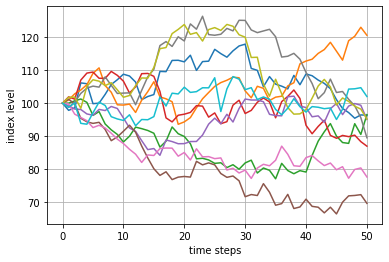

In [3]:
# 기하 브라운 운동 모형에 대한 몬테카를로 경로를 생성하는 함수를 정의하자
def gen_paths(S0, r, sigma, T, M, I):
    ''' Generate Monte Carlo paths for geometric Brownian motion.
    
    Parameters
    ==========
    S0 : float
        initial stock/index value
    r : float
        constant short rate
    sigma : float
        constant volatility
    T : float
        final time horizon
    M : int
        number of time steps/intervals
    I : int
        number of paths to be simulated
        
    Returns
    =======
    paths : ndarray, shape (M + 1, I)
        simulated paths given the parameters
    '''
    dt = float(T) / M
    paths = np.zeros((M + 1, I), np.float64)
    paths[0] = S0
    for t in range(1, M + 1):
        rand = np.random.standard_normal(I)
        rand = (rand - rand.mean()) / rand.std()
        paths[t] = paths[t - 1] * np.exp((r - 0.5 * sigma ** 2) * dt +
                                         sigma * np.sqrt(dt) * rand)
    return paths

# 입력변수의 한 예
S0 = 100.
r = 0.05
sigma = 0.2
T = 1.0
M = 50
I = 250000

paths = gen_paths(S0, r, sigma, T, M, I)

# 시뮬레이션 경로 중 10개를 보이자
plt.plot(paths[:, :10])
plt.grid(True)
plt.xlabel('time steps')
plt.ylabel('index level')
# tag: normal_sim_1
# title: 10 simulated paths of geometric Brownian motion


In [4]:
# 로그 수익률 분포를 알아보자
log_returns = np.log(paths[1:] / paths[0:-1])

# 첫 시뮬레이션 경로의 50개의 시간 구간 값
print(paths[:, 0].round(4))
print('\n')

# 이 시뮬레이션 경로에 대한 로그 수익률
print(log_returns[:, 0].round(4))
print('\n')



[100.      97.821   98.5573 106.1546 105.899   99.8363 100.0145 102.6589
 105.6643 107.1107 108.7943 108.2449 106.4105 101.0575 102.0197 102.6052
 109.6419 109.5725 112.9766 113.0225 112.5476 114.5585 109.942  112.6271
 112.7502 116.3453 115.0443 113.9586 115.8831 117.3705 117.9185 110.5539
 109.9687 104.9957 108.0679 105.7822 105.1585 104.3304 108.4387 105.5963
 108.866  108.3284 107.0077 106.0034 104.3964 101.0637  98.3776  97.135
  95.4254  96.4271  96.3386]


[-0.022   0.0075  0.0743 -0.0024 -0.059   0.0018  0.0261  0.0289  0.0136
  0.0156 -0.0051 -0.0171 -0.0516  0.0095  0.0057  0.0663 -0.0006  0.0306
  0.0004 -0.0042  0.0177 -0.0411  0.0241  0.0011  0.0314 -0.0112 -0.0095
  0.0167  0.0128  0.0047 -0.0645 -0.0053 -0.0463  0.0288 -0.0214 -0.0059
 -0.0079  0.0386 -0.0266  0.0305 -0.0049 -0.0123 -0.0094 -0.0153 -0.0324
 -0.0269 -0.0127 -0.0178  0.0104 -0.0009]




In [8]:
# 통계치 함수
def print_statistics(array):
    ''' Prints selected statistics.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    sta = stats.describe(array)
    print("%14s %15s" % ('statistic', 'value'))
    print(30 * "-")
    print("%14s %15.5f" % ('size', sta[0]))
    print("%14s %15.5f" % ('min', sta[1][0]))
    print("%14s %15.5f" % ('max', sta[1][1]))
    print("%14s %15.5f" % ('mean', sta[2]))
    print("%14s %15.5f" % ('std', np.sqrt(sta[3])))
    print("%14s %15.5f" % ('skew', sta[4]))
    print("%14s %15.5f" % ('kurtosis', sta[5]))

print_statistics(log_returns.flatten())


statistic           value
------------------------------
          size  12500000.00000
           min        -0.15664
           max         0.15371
          mean         0.00060
           std         0.02828
          skew         0.00055
      kurtosis         0.00085


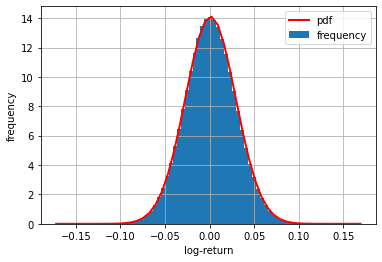

In [10]:
# 시뮬레이션된 로그 수익률 분포와 주어진 r, sigma 값에 대한 정규분포의 확률 밀도 함수를 비교해보자.

# 거의 일치한다.
plt.hist(log_returns.flatten(), bins=70, density=True, label='frequency')
plt.grid(True)
plt.xlabel('log-return')
plt.ylabel('frequency')
x = np.linspace(plt.axis()[0], plt.axis()[1])
plt.plot(x, stats.norm.pdf(x, loc= r / M, scale=sigma / np.sqrt(M)),
         'r', lw=2.0, label='pdf')
plt.legend()
# tag: normal_sim_2
# title: Histogram of log-returns and normal density function

Text(0, 0.5, 'sample quantiles')

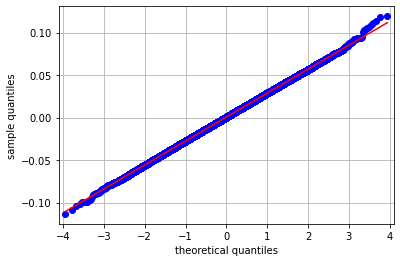

In [11]:
# 이론적인 확률 밀도 함수와 실제 히스토그램을 비교하는 것만이 정규성을 시각적으로 테스트 하기 위한 유일한 방법은 아니다.
# 이른바 분위수 대조도 (quantile-quantile plots) 또는 Q-Q 플롯을 사용할 수도 있다.
# Q-Q 플롯은 샘플값의 샘플 분위수(quantile)와 정규분포 상의 이론적 분위수를 비교한 것이다.
# 샘플 자료가 정규분포를 가진다면 대다수의 분위수 값의 쌍이 일직선을 이루게 된다.

sm.qqplot(log_returns.flatten()[::500], line='s')
plt.grid(True)
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles')
# tag: sim_val_qq_1
# title: Quantile-quantile plot for log returns

In [12]:
# 시각적 비교가 인상적이긴 하지만 엄밀한 검정 절차를 대체할 수는 없다.
# 다음에 제시한 normality_test 함수는 세 가지 통계적 검정 결과를 보인다.

# (1) 왜도 검정(skew test) : 이 검정은 샘플 자료의 왜도(skewness)가 정규분포와 일치하는지(0에 가까운 값을 가지는지) 판단한다.
# (2) 첨도 검정(kurtosis test) : 마찬가지로 이 검정은 샘플 자료의 첨도가 정규분포와 일치하는지(0에 가까운 값을 가지는지) 판단한다.
# (3) 정규성 검정(normal test) : 이 검정은 다른 두 검정 방법을 조합한다.

# 일반적으로 정규분포의 첨도는 3임. 여기서는 첨도에서 정규분포의 값인 3을 뺀 초과 첨도를 첨도라고 부를 예정

def normality_tests(arr):
    ''' Tests for normality distribution of given data set.
    
    Parameters
    ==========
    array: ndarray
        object to generate statistics on
    '''
    print("Skew of data set  %14.3f" % stats.skew(arr))
    print("Skew test p-value %14.3f" % stats.skewtest(arr)[1])
    print("Kurt of data set  %14.3f" % stats.kurtosis(arr))
    print("Kurt test p-value %14.3f" % stats.kurtosistest(arr)[1])
    print("Norm test p-value %14.3f" % stats.normaltest(arr)[1])

# 검정 결과 유의 확률(p-value)이 0.05 이상이므로 로그 수익률이 정규분포임을 나타내고 있다.
print(normality_tests(log_returns.flatten()))

Skew of data set           0.001
Skew test p-value          0.430
Kurt of data set           0.001
Kurt test p-value          0.541
Norm test p-value          0.607
None


statistic           value
------------------------------
          size    250000.00000
           min        42.74870
           max       233.58435
          mean       105.12645
           std        21.23174
          skew         0.61116
      kurtosis         0.65182
     statistic           value
------------------------------
          size    250000.00000
           min         3.75534
           max         5.45354
          mean         4.63517
           std         0.19998
          skew        -0.00092
      kurtosis        -0.00327
Skew of data set          -0.001
Skew test p-value          0.851
Kurt of data set          -0.003
Kurt test p-value          0.744
Norm test p-value          0.931


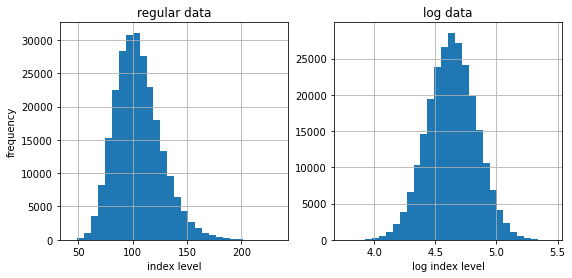

In [13]:
# 마지막으로 만기의 값이 로그 정규분포를 이루는지 확인해보자.
# 로그 함수를 적용하여 자료를 변환한 후에(변환에 의해 정규분포가 되었을 수도 있고 아닐 수도 있다) 마찬가지로 정규성 검정을 한다.
# 로그 정규분포를 이루는 만기 값의 분포와 로그 변환을 적용한 이후의 분포를 보여보자

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))
ax1.hist(paths[-1], bins=30)
ax1.grid(True)
ax1.set_xlabel('index level')
ax1.set_ylabel('frequency')
ax1.set_title('regular data')
ax2.hist(np.log(paths[-1]), bins=30)
ax2.grid(True)
ax2.set_xlabel('log index level')
ax2.set_title('log data')
# tag: normal_sim_3
# title: Histogram of simulated end-of-period index levels
# size: 90

# 자료의 평균은 105에 가깝고 표준편차(변동성)은 20%에 가깝다
print_statistics(paths[-1])

# 로그 변환한 값은 왜도와 첨도 값이 0에 가깝다
print_statistics(np.log(paths[-1]))

# 높은 유의 확률을 보이고 있으므로 정규분포 가설을 강하게 지지한다.
normality_tests(np.log(paths[-1]))



Text(0, 0.5, 'sample quantiles')

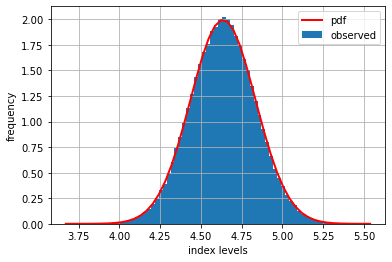

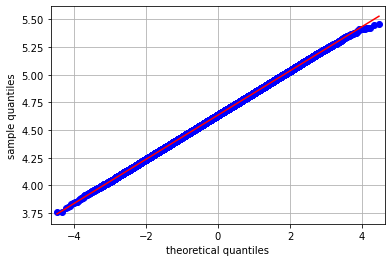

In [16]:
# 정규분포의 확률 밀도 함수와 실제 히스토그램을 비교해보자. 예상대로 일치한다.
log_data = np.log(paths[-1])
plt.hist(log_data, bins=70, density=True, label='observed')
plt.grid(True)
plt.xlabel('index levels')
plt.ylabel('frequency')
x = np.linspace(plt.axis()[0], plt.axis()[1])
plt.plot(x, stats.norm.pdf(x, log_data.mean(), log_data.std()),
         'r', lw=2.0, label='pdf')
plt.legend()
# tag: normal_sim_4
# title: Histogram of log index levels and normal density function

# 로그 변환한 값이 정규분포인지 시각화 해보자
sm.qqplot(log_data, line='s')
plt.grid(True)
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles')
# tag: sim_val_qq_2
# title: Quantile-quantile plot for log index levels

In [19]:
# 현실 자료를 분석해보자
# 두 개의 주가지수(금 지수, S&P500)와 두 개의 개별 종목(애플, 마이크로소프트) 주가 시계열을 분석해보자.
# SPDR S&P 500 Trust ETF : SPY
# SPDR골드셰어즈 : GLD

import os 
import pandas as pd
path = os.getcwd()

os.chdir(path)

raw = pd.read_csv('./source/tr_eikon_eod_data.csv',
                 index_col=0, parse_dates=True)

symbols = ['SPY', 'GLD', 'AAPL.O', 'MSFT.O']

data = raw[symbols]
data = data.dropna()

print(data.info())
print(data.head())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1972 entries, 2010-01-04 to 2017-10-31
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   SPY     1972 non-null   float64
 1   GLD     1972 non-null   float64
 2   AAPL.O  1972 non-null   float64
 3   MSFT.O  1972 non-null   float64
dtypes: float64(4)
memory usage: 77.0 KB
None
               SPY     GLD     AAPL.O  MSFT.O
Date                                         
2010-01-04  113.33  109.80  30.572827  30.950
2010-01-05  113.63  109.70  30.625684  30.960
2010-01-06  113.71  111.51  30.138541  30.770
2010-01-07  114.19  110.82  30.082827  30.452
2010-01-08  114.57  111.37  30.282827  30.660


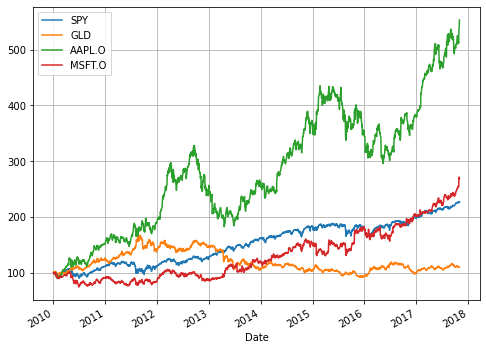

In [21]:
# 4개의 시계열을 직접 비교하기 위해 모든 시작값을 100으로 정규화하였다.
(data / data.iloc[0] * 100).plot(figsize=(8, 6), grid=True)
# tag: real_returns_1
# title: Evolution of stock and index levels over time

SPY       GLD    AAPL.O    MSFT.O
Date                                              
2010-01-04       NaN       NaN       NaN       NaN
2010-01-05  0.002644 -0.000911  0.001727  0.000323
2010-01-06  0.000704  0.016365 -0.016034 -0.006156
2010-01-07  0.004212 -0.006207 -0.001850 -0.010389
2010-01-08  0.003322  0.004951  0.006626  0.006807


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000027D041CAD68>,
      dtype=object)

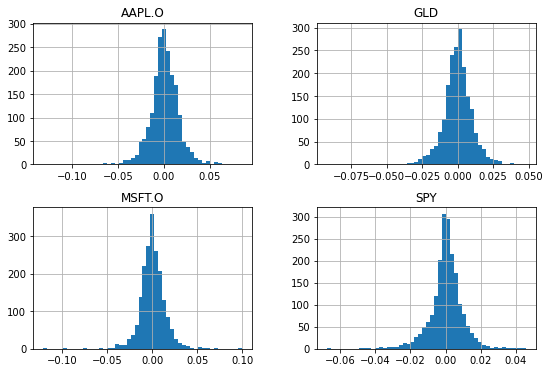

In [22]:
# 로그 수익률 계산
log_returns = np.log(data / data.shift(1))
print(log_returns.head())

# 히스토그램 형태로 모든 로그 수익률 확인
log_returns.hist(bins=50, figsize=(9, 6))
# tag: real_returns_2
# title: Histogram of respective log-returns
# size: 90

In [23]:
# 다음 단계로 각각의 시계열에 대해 통계치를 구한다.
# 모든 시계열 자료에 대해 첨도 값은 정규 분포와 거리가 멈을 알 수 있다.
for sym in symbols:
    print("\nResults for symbol %s" % sym)
    print(30 * "-")
    log_data = np.array(log_returns[sym].dropna())
    print_statistics(log_data)


Results for symbol SPY
------------------------------
     statistic           value
------------------------------
          size      1971.00000
           min        -0.06734
           max         0.04545
          mean         0.00042
           std         0.00934
          skew        -0.46886
      kurtosis         4.54265

Results for symbol GLD
------------------------------
     statistic           value
------------------------------
          size      1971.00000
           min        -0.09191
           max         0.04795
          mean         0.00005
           std         0.01048
          skew        -0.60078
      kurtosis         5.42113

Results for symbol AAPL.O
------------------------------
     statistic           value
------------------------------
          size      1971.00000
           min        -0.13187
           max         0.08502
          mean         0.00087
           std         0.01605
          skew        -0.26179
      kurtosis         4.9

Text(0, 0.5, 'sample quantiles')

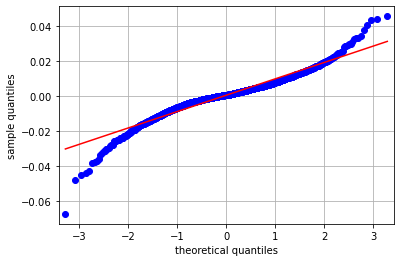

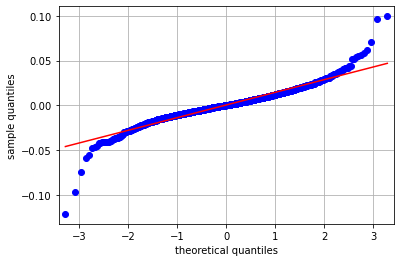

In [24]:
# QQ 플롯으로 두 자료만 조사해보자.
# 샘플 분위수가 직선이 아니므로 정규분포를 이루지 않는다는 것을 명확히 알 수 있다.
# 이 시계열 자료는 팻 테일(fat tail)현상을 보임을 알 수 있다. 즉 분포 양쪽의 이상치들이 정규분포보다 훨씬 더 양수이거나 음수인 경우를 말한다.
sm.qqplot(log_returns['SPY'].dropna(), line='s')
plt.grid(True)
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles')
# tag: real_val_qq_1
# title: Quantile-quantile plot for S&P 500 log returns

# 마이크로소프트 주식 자료의 결과. 역시 강한 팻 테일 분포의 증거가 존재
sm.qqplot(log_returns['MSFT.O'].dropna(), line='s')
plt.grid(True)
plt.xlabel('theoretical quantiles')
plt.ylabel('sample quantiles')
# tag: real_val_qq_2
# title: Quantile-quantile plot for Microsoft log returns

In [25]:
# 정식 정규성 검정
for sym in symbols:
    print("\nResults for symbol %s" % sym)
    print(32 * "-")
    log_data = np.array(log_returns[sym].dropna())
    normality_tests(log_data)


Results for symbol SPY
--------------------------------
Skew of data set          -0.469
Skew test p-value          0.000
Kurt of data set           4.543
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol GLD
--------------------------------
Skew of data set          -0.601
Skew test p-value          0.000
Kurt of data set           5.421
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol AAPL.O
--------------------------------
Skew of data set          -0.262
Skew test p-value          0.000
Kurt of data set           4.922
Kurt test p-value          0.000
Norm test p-value          0.000

Results for symbol MSFT.O
--------------------------------
Skew of data set          -0.101
Skew test p-value          0.067
Kurt of data set           7.701
Kurt test p-value          0.000
Norm test p-value          0.000
